# LightGlue Demo
In this notebook we match two pairs of images using LightGlue with early stopping and point pruning.

In [2]:
# If we are on colab: this clones the repo and installs the dependencies
from pathlib import Path
if Path.cwd().name != 'LightGlue':
  print(Path.cwd())
  # !git clone --quiet https://github.com/cvg/LightGlue/
  # %cd LightGlue
  # %pip install --progress-bar off --quiet -e .
else:
  print(Path.cwd())


/simonyang/SimonWorkspace/Semi-SupervisedContactDetection/LightGlue


In [4]:
from lightglue import LightGlue, SuperPoint, DISK
from lightglue.utils import load_image, rbd
from lightglue import viz2d
import torch
torch.set_grad_enabled(False);
images = Path('assets')

## Load extractor and matcher module
In this example we use SuperPoint features combined with LightGlue.

In [5]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  # 'mps', 'cpu'

extractor = SuperPoint(max_num_keypoints=2048).eval().to(device)  # load the extractor
matcher = LightGlue(features='superpoint').eval().to(device)

Downloading: "https://github.com/cvg/LightGlue/releases/download/v0.1_arxiv/superpoint_v1.pth" to /root/.cache/torch/hub/checkpoints/superpoint_v1.pth
100%|██████████| 4.96M/4.96M [00:01<00:00, 3.44MB/s]
Downloading: "https://github.com/cvg/LightGlue/releases/download/v0.1_arxiv/superpoint_lightglue.pth" to /root/.cache/torch/hub/checkpoints/superpoint_lightglue_v0-1_arxiv-pth
100%|██████████| 45.3M/45.3M [00:13<00:00, 3.52MB/s]


## Easy example
The top image shows the matches, while the bottom image shows the point pruning across layers. In this case, LightGlue prunes a few points with occlusions, but is able to stop the context aggregation after 4/9 layers.

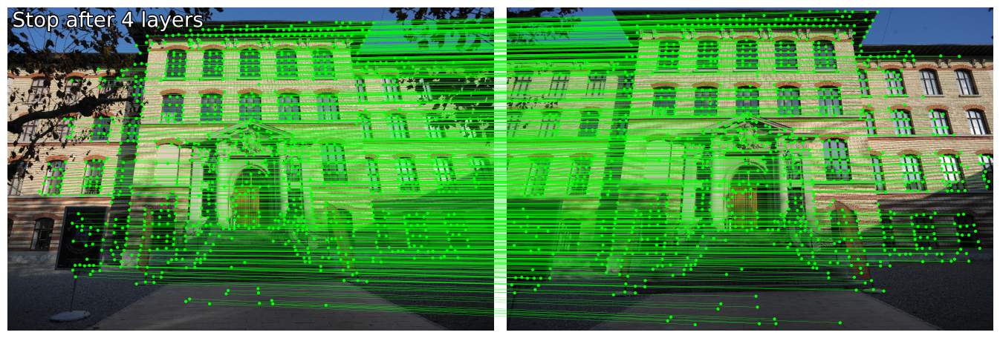

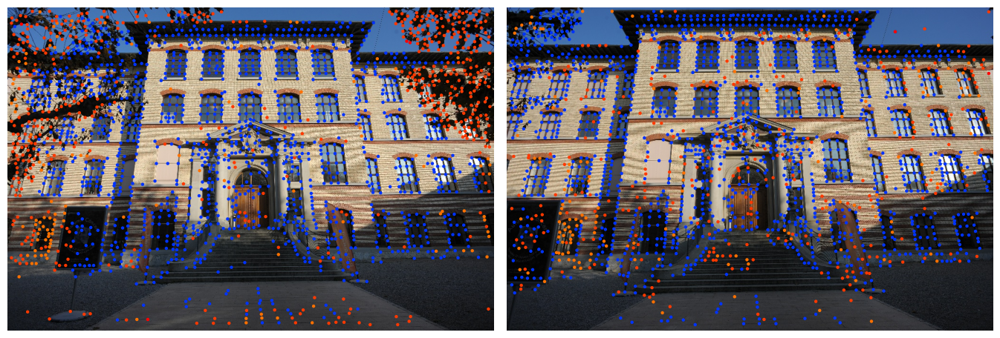

In [6]:
image0 = load_image(images / 'DSC_0411.JPG')
image1 = load_image(images / 'DSC_0410.JPG')

feats0 = extractor.extract(image0.to(device))
feats1 = extractor.extract(image1.to(device))
matches01 = matcher({'image0': feats0, 'image1': feats1})
feats0, feats1, matches01 = [rbd(x) for x in [feats0, feats1, matches01]]  # remove batch dimension

kpts0, kpts1, matches = feats0['keypoints'], feats1['keypoints'], matches01['matches']
m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

axes = viz2d.plot_images([image0, image1])
viz2d.plot_matches(m_kpts0, m_kpts1, color='lime', lw=0.2)
viz2d.add_text(0, f'Stop after {matches01["stop"]} layers', fs=20)

kpc0, kpc1 = viz2d.cm_prune(matches01['prune0']), viz2d.cm_prune(matches01['prune1'])
viz2d.plot_images([image0, image1])
viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=10)

## Difficult example
For pairs with significant viewpoint- and illumination changes, LightGlue can exclude a lot of points early in the matching process (red points), which significantly reduces the inference time.

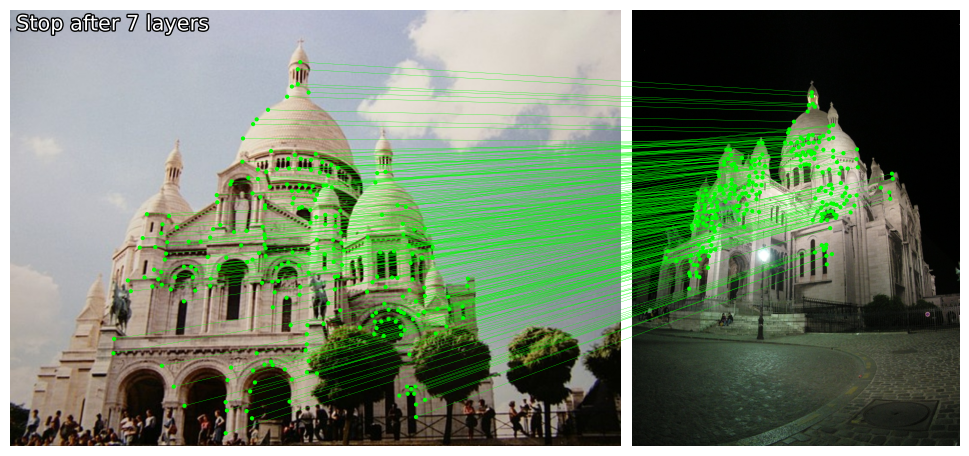

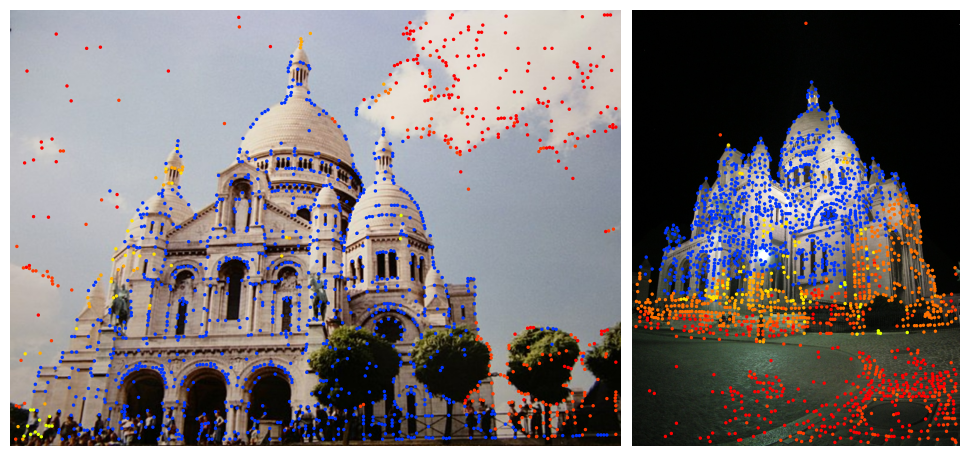

In [7]:
image0 = load_image(images / 'sacre_coeur1.jpg')
image1 = load_image(images / 'sacre_coeur2.jpg')

feats0 = extractor.extract(image0.to(device))
feats1 = extractor.extract(image1.to(device))
matches01 = matcher({'image0': feats0, 'image1': feats1})
feats0, feats1, matches01 = [rbd(x) for x in [feats0, feats1, matches01]]  # remove batch dimension

kpts0, kpts1, matches = feats0['keypoints'], feats1['keypoints'], matches01['matches']
m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

axes = viz2d.plot_images([image0, image1])
viz2d.plot_matches(m_kpts0, m_kpts1, color='lime', lw=0.2)
viz2d.add_text(0, f'Stop after {matches01["stop"]} layers')

kpc0, kpc1 = viz2d.cm_prune(matches01['prune0']), viz2d.cm_prune(matches01['prune1'])
viz2d.plot_images([image0, image1])
viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=6)

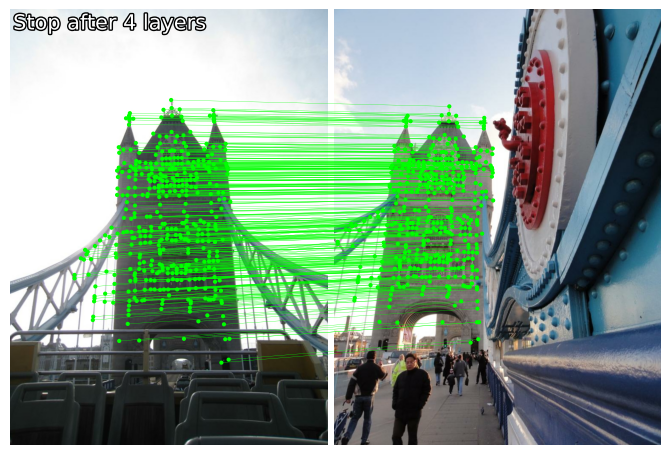

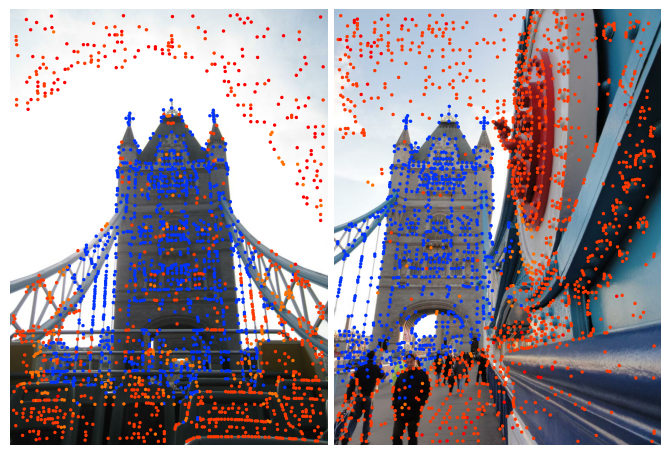

In [8]:
image0 = load_image(images / 'london_bridge1.jpg')
image1 = load_image(images / 'london_bridge2.jpg')

feats0 = extractor.extract(image0.to(device))
feats1 = extractor.extract(image1.to(device))
matches01 = matcher({'image0': feats0, 'image1': feats1})
feats0, feats1, matches01 = [rbd(x) for x in [feats0, feats1, matches01]]  # remove batch dimension

kpts0, kpts1, matches = feats0['keypoints'], feats1['keypoints'], matches01['matches']
m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

axes = viz2d.plot_images([image0, image1])
viz2d.plot_matches(m_kpts0, m_kpts1, color='lime', lw=0.2)
viz2d.add_text(0, f'Stop after {matches01["stop"]} layers')

kpc0, kpc1 = viz2d.cm_prune(matches01['prune0']), viz2d.cm_prune(matches01['prune1'])
viz2d.plot_images([image0, image1])
viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=6)

In [26]:
def superglue(image0_path, image1_path):
    image0 = load_image(image0_path)
    image1 = load_image(image1_path)
    # image0 = load_image(images / image0_path)
    # image1 = load_image(images / image1_path)

    feats0 = extractor.extract(image0.to(device))
    feats1 = extractor.extract(image1.to(device))
    matches01 = matcher({'image0': feats0, 'image1': feats1})
    feats0, feats1, matches01 = [rbd(x) for x in [feats0, feats1, matches01]]  # remove batch dimension

    kpts0, kpts1, matches = feats0['keypoints'], feats1['keypoints'], matches01['matches']
    m_kpts0, m_kpts1 = kpts0[matches[..., 0]], kpts1[matches[..., 1]]

    axes = viz2d.plot_images([image0, image1])
    viz2d.plot_matches(m_kpts0, m_kpts1, color='lime', lw=0.2)
    viz2d.add_text(0, f'Stop after {matches01["stop"]} layers')

    kpc0, kpc1 = viz2d.cm_prune(matches01['prune0']), viz2d.cm_prune(matches01['prune1'])
    viz2d.plot_images([image0, image1])
    viz2d.plot_keypoints([kpts0, kpts1], colors=[kpc0, kpc1], ps=6)
    


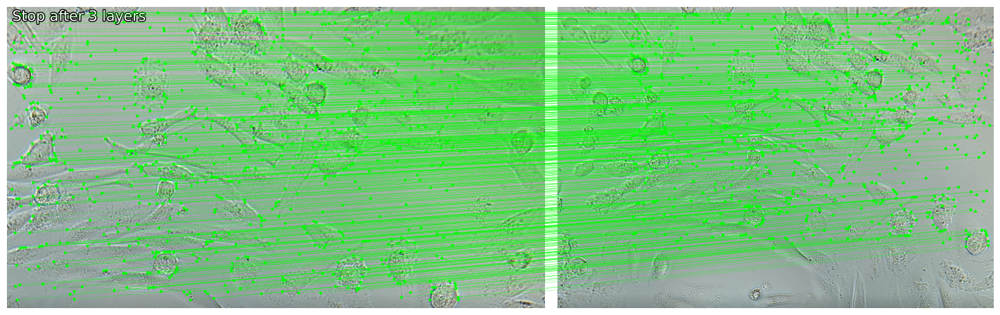

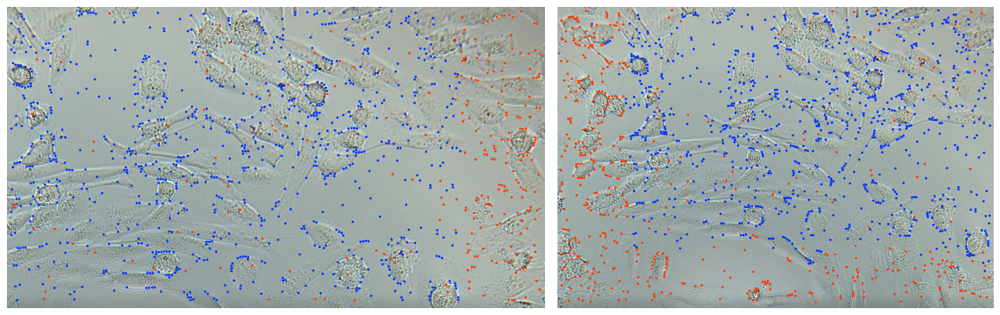

In [27]:
image0_path = 'assets/cancer3.png'
image1_path = 'assets/cancer4.png'

superglue(image0_path, image1_path)

['assets/data/part_0.jpg', 'assets/data/part_2.jpg', 'assets/data/part_1.jpg', 'assets/data/part_3.jpg']
Pairs Numbers: 6.


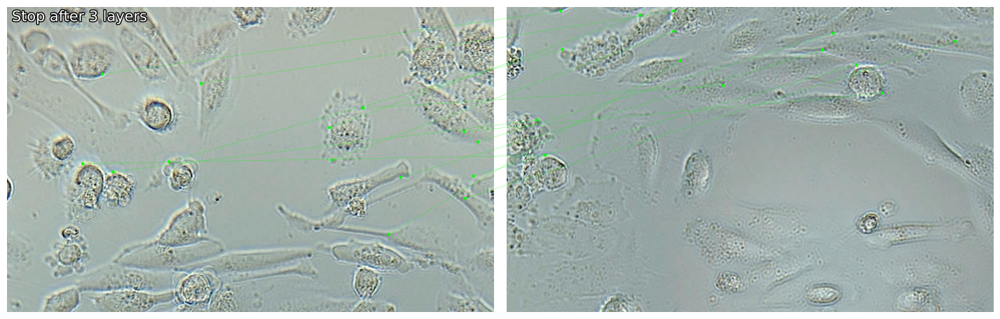

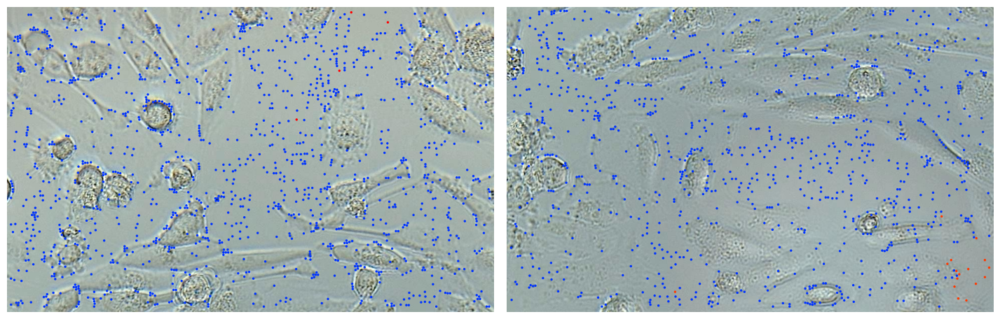

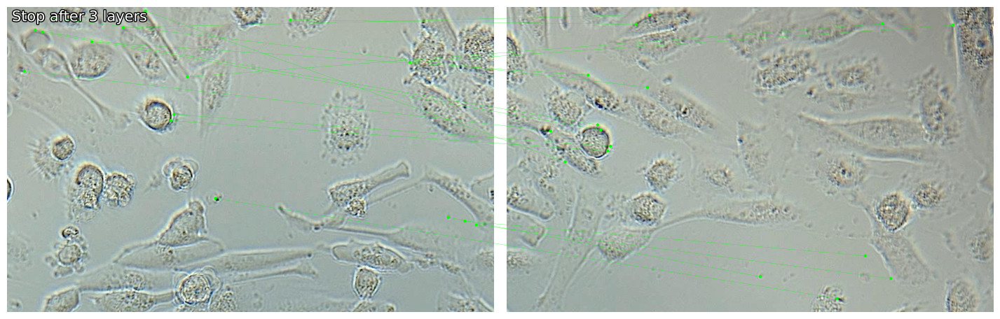

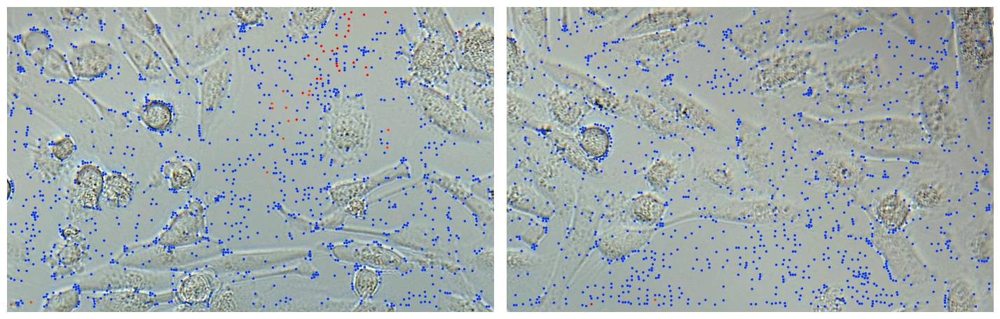

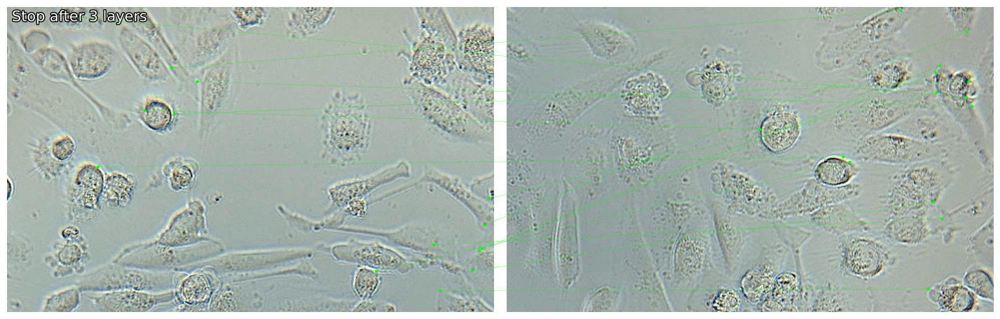

...

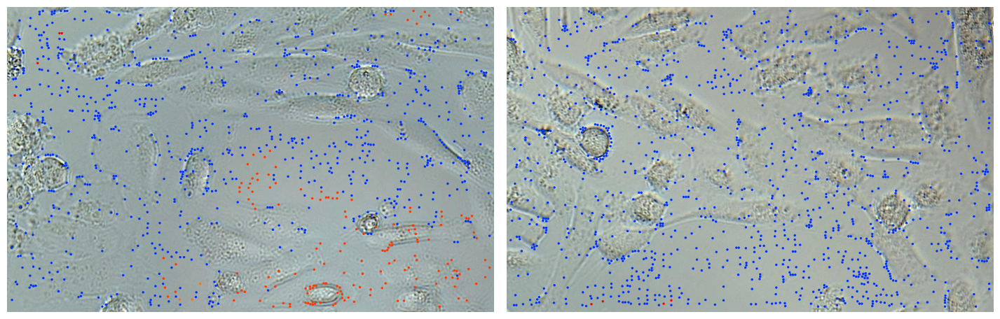

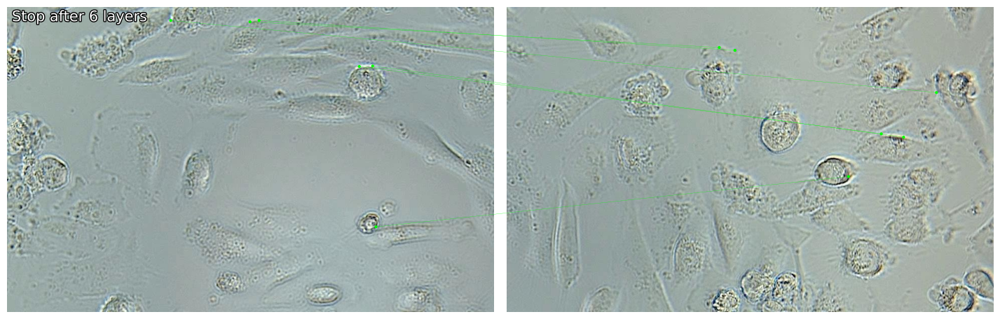

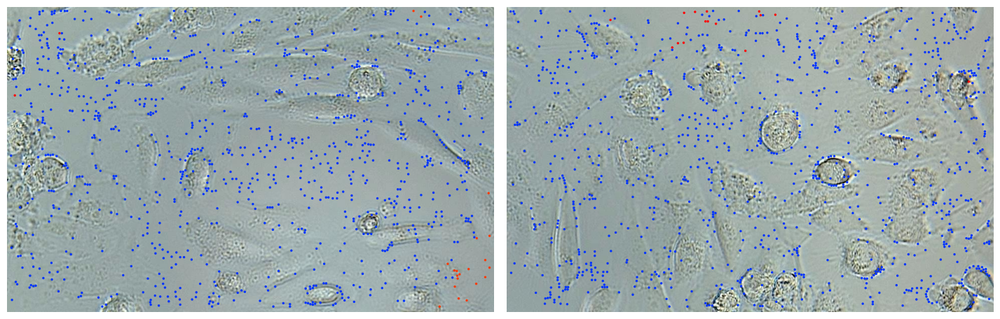

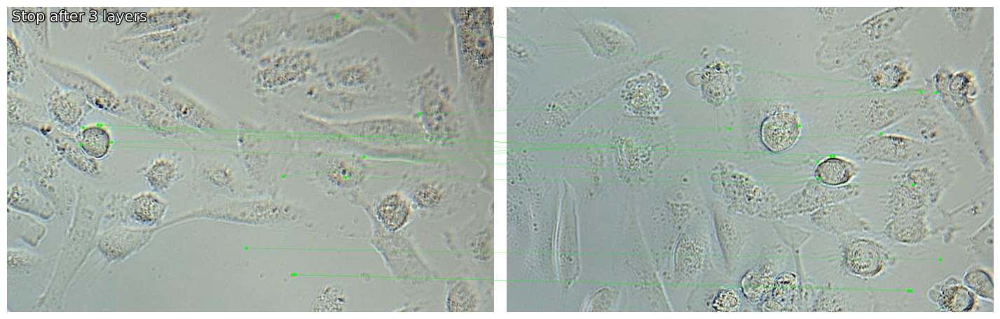

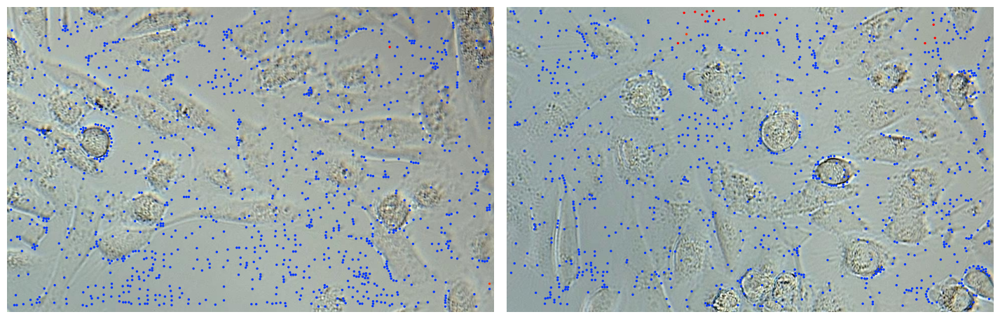

In [31]:
import os
import itertools

# 获取目录中的所有文件
directory = 'assets/data/'
files = [os.path.join(directory, f) for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]
print(files)

# 创建所有可能的两两配对
pairs = list(itertools.combinations(files, 2))
print("Pairs Numbers: {}.".format(len(pairs)))

# 对每一对文件调用 superglue() 函数
for pair in pairs:
    superglue(*pair)